# Original Dataset

In [8]:
# Install Essential Libraries
!pip install ultralytics ray

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.2/66.2 MB 56.5 MB/s eta 0:00:0000:0100:01


In [3]:
!pip install kagglehub

In [1]:
# Import Essential Libraries
import os
import random
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np  
import matplotlib.pyplot as plt
import seaborn as sns
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import warnings
warnings.filterwarnings('ignore')

In [2]:
import kagglehub

# Download latest version
kaggle_path = kagglehub.dataset_download("pkdarabi/cardetection")

print("Path to dataset files:", kaggle_path)

Path to dataset files: /home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5


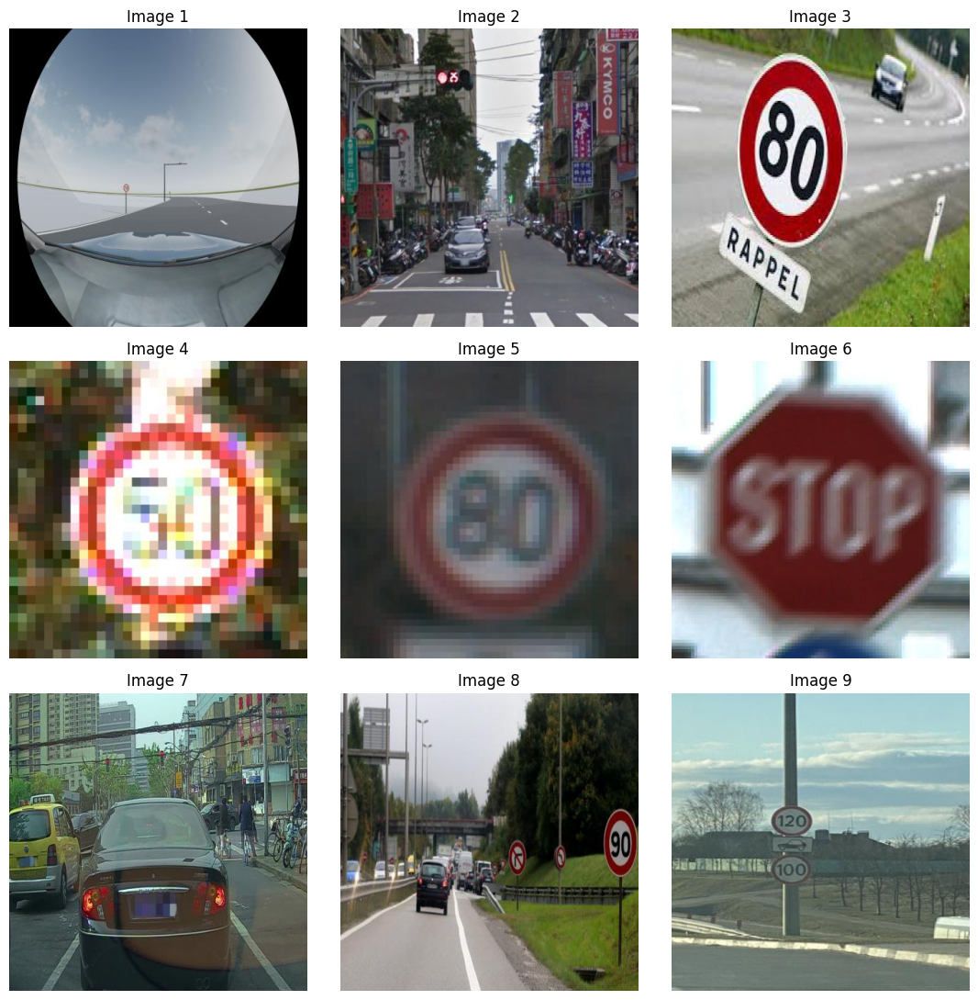

In [3]:
Image_dir = '/home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/train/images'

num_samples = 9
image_files = os.listdir(Image_dir)

# Randomly select num_samples images
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(Image_dir, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [5]:
# Get the size of the image
image = cv2.imread("/home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/train/images/00000_00000_00012_png.rf.23f94508dba03ef2f8bd187da2ec9c26.jpg")
h, w, c = image.shape
print(f"The image has dimensions {w}x{h} and {c} channels.")

The image has dimensions 416x416 and 3 channels.



image 1/1 /home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/train/images/000005_jpg.rf.d730849ae93a7c211a7c8f57ed851028.jpg: 640x640 1 car, 3.3ms
Speed: 3.2ms preprocess, 3.3ms inference, 79.2ms postprocess per image at shape (1, 3, 640, 640)


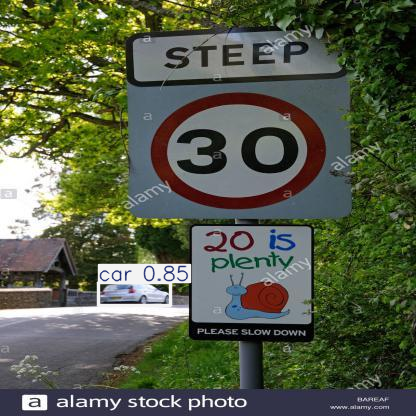

In [6]:
# Use a pretrained YOLOv8n model
model = YOLO("yolov8n.pt") 

# Use the model to detect object
image = "/home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/train/images/000005_jpg.rf.d730849ae93a7c211a7c8f57ed851028.jpg"
result_predict = model.predict(source = image, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [4]:
# Build from YAML and transfer weights
Final_model = YOLO('yolov8n.pt')  

# Training The Final Model
Result_Final_model = Final_model.train(data="/home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/data.yaml",epochs = 10, batch = 32, optimizer = 'sgd', lr0=0.01)


Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/data.yaml, epochs=10, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train9, exist_ok=False, pretrained=True, optimizer=sgd, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=

train: Scanning /home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/train/labels.cache... 3530 
val: Scanning /home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/valid/labels.cache... 801 ima


Plotting labels to runs/detect/train9/labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train9
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      4.16G     0.8833       4.21      1.247         14        640: 100%|██████████| 111/111 [00:15<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.256      0.241      0.201      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      4.18G     0.7854      2.797      1.109         14        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.342      0.493      0.377      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      4.18G     0.7908      2.259      1.102         12        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.449      0.442      0.396      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      4.17G     0.7942      1.973      1.111         11        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.669      0.452       0.53      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      4.18G     0.7506      1.563      1.079         12        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.663       0.63      0.693      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      4.19G     0.7127      1.286      1.047         12        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.798      0.678       0.78       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      4.18G     0.6814      1.101      1.022         13        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.831      0.745      0.823      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      4.19G     0.6428      0.945          1         11        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.895      0.737      0.844      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      4.19G     0.6181     0.8523     0.9801         18        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.921      0.781      0.889      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      4.19G     0.5883     0.7556     0.9604         10        640: 100%|██████████| 111/111 [00:14<00:00,  7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<

                   all        801        944      0.946      0.822      0.906      0.774



10 epochs completed in 0.047 hours.
Optimizer stripped from runs/detect/train9/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train9/weights/best.pt, 6.2MB

Validating runs/detect/train9/weights/best.pt...
Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
Model summary (fused): 168 layers, 3,008,573 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<


                   all        801        944      0.946      0.822      0.906      0.774
           Green Light         87        122      0.807      0.648      0.718       0.41
             Red Light         74        108      0.948      0.509      0.761      0.415
       Speed Limit 100         52         52      0.823      0.942      0.942      0.848
       Speed Limit 110         17         17      0.928      0.762      0.855      0.777
       Speed Limit 120         60         60      0.984       0.85      0.973      0.887
        Speed Limit 20         56         56      0.984      0.893      0.971      0.825
        Speed Limit 30         71         74          1      0.955      0.967      0.888
        Speed Limit 40         53         55      0.961      0.906      0.958      0.833
        Speed Limit 50         68         71      0.983      0.789      0.923      0.834
        Speed Limit 60         76         76      0.944      0.882      0.933      0.842
        Speed Limit 7

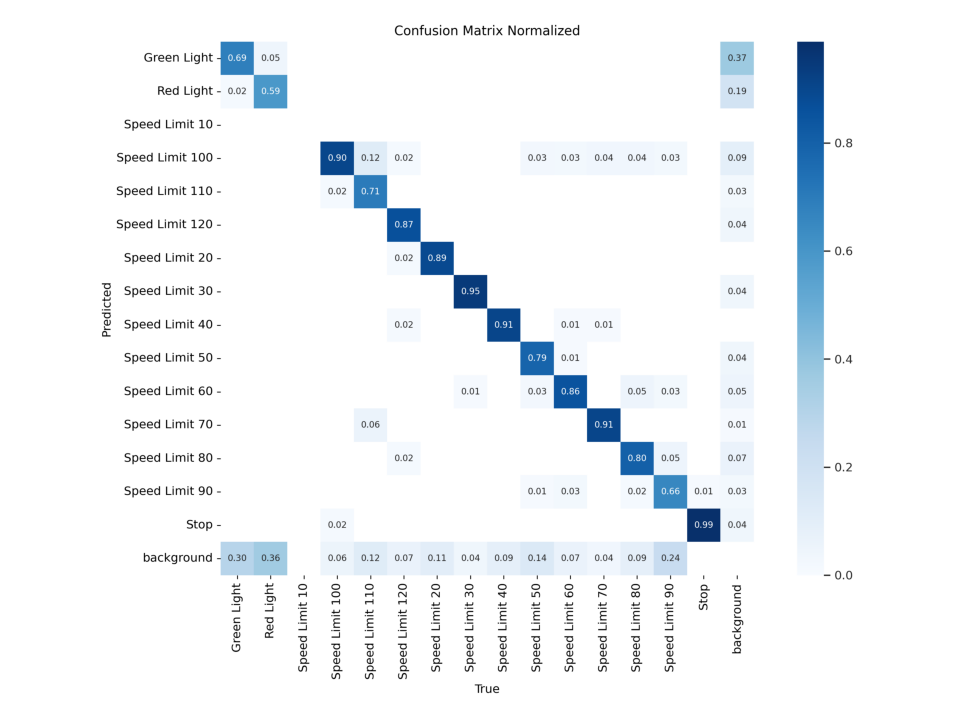

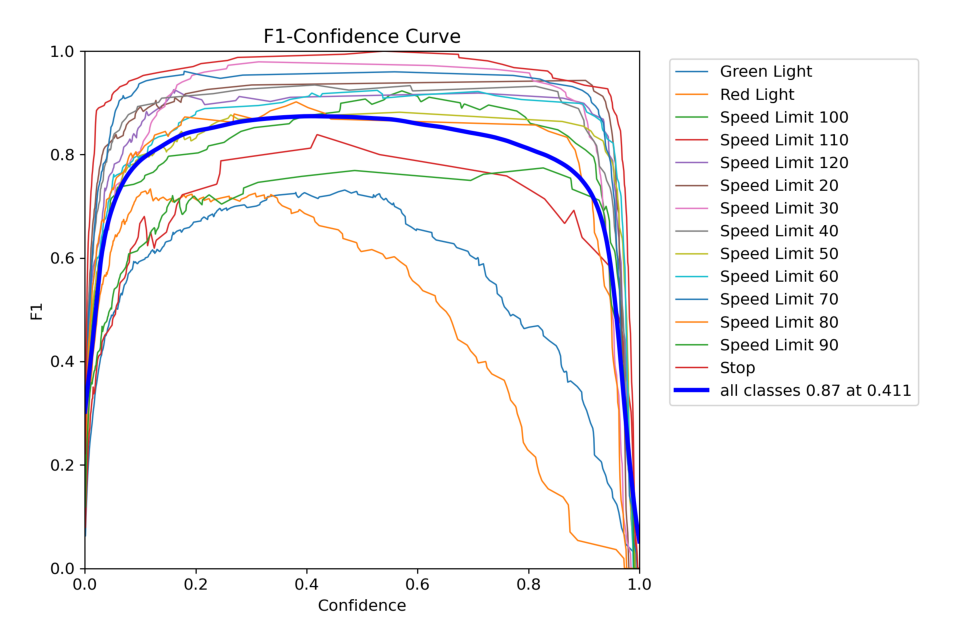

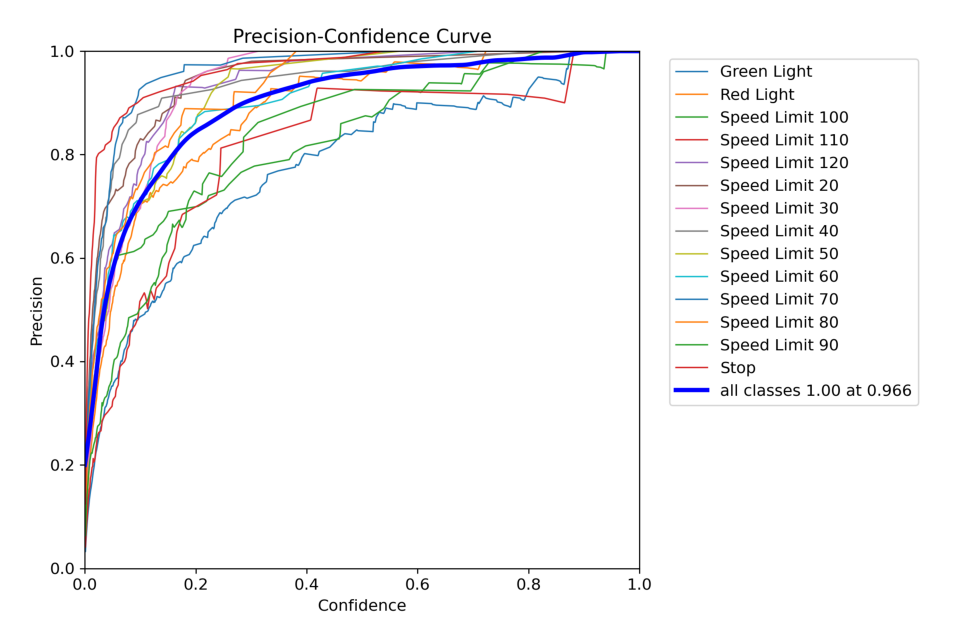

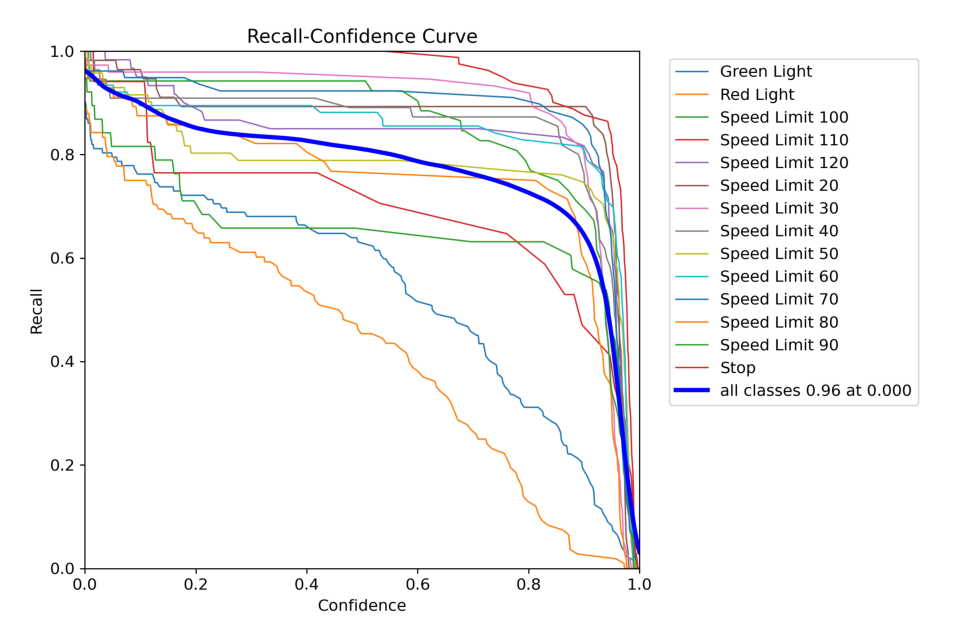

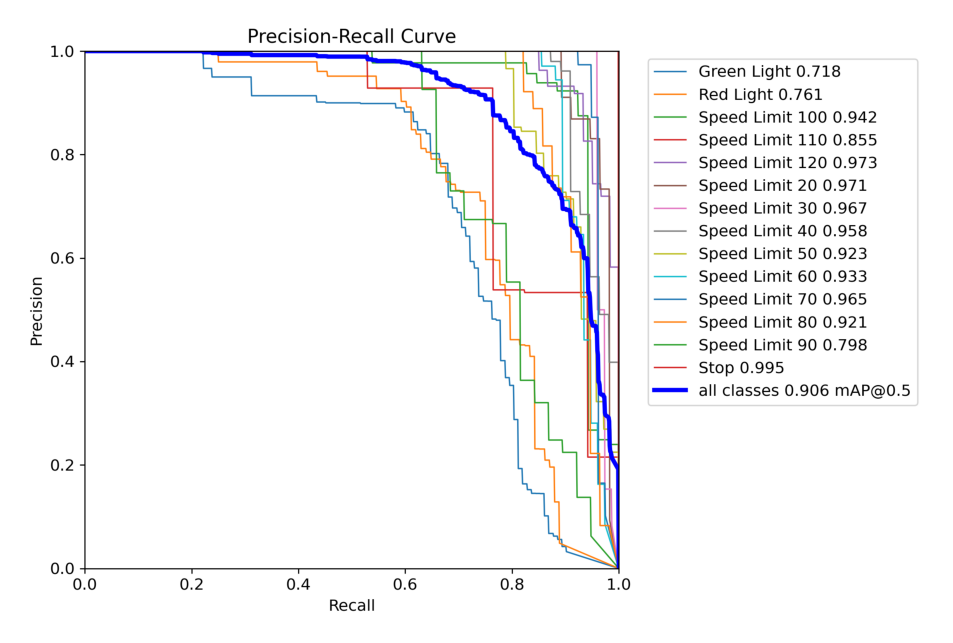

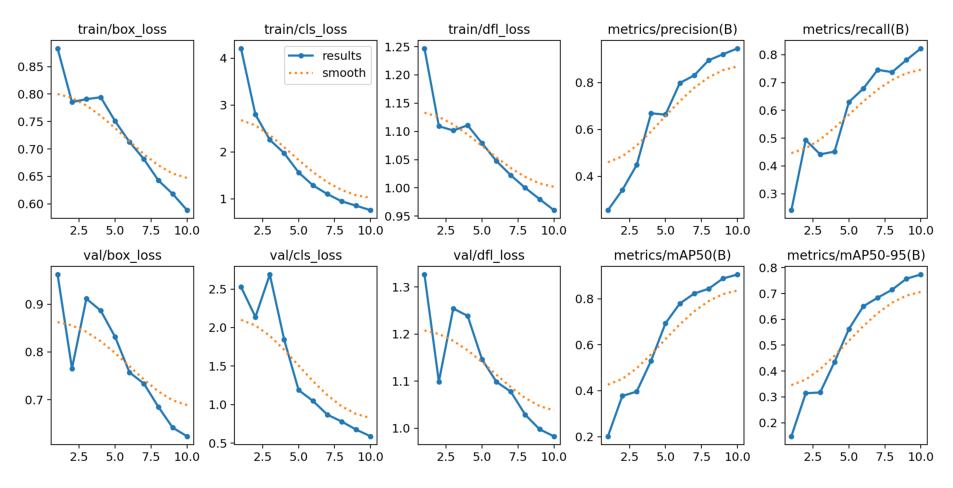

In [6]:
import os
import cv2
import matplotlib.pyplot as plt

def display_images(post_training_files_path, image_files):

    for image_file in image_files:
        image_path = os.path.join(post_training_files_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        plt.figure(figsize=(10, 10), dpi=120)
        plt.imshow(img)
        plt.axis('off')
        plt.show()

# List of image files to display
image_files = [
    'confusion_matrix_normalized.png',
    'F1_curve.png',
    'P_curve.png',
    'R_curve.png',
    'PR_curve.png',
    'results.png'
]

# Path to the directory containing the images
post_training_files_path = './runs/detect/train9'

# Display the images
display_images(post_training_files_path, image_files)


In [7]:
Result_Final_model = pd.read_csv('./runs/detect/train9/results.csv')
Result_Final_model.head(10)

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,18.2811,0.88330,4.20996,1.24689,0.25600,0.24091,0.20147,0.14726,0.96213,2.52729,1.32651,0.070270,0.003303,0.003303
1,2,35.4194,0.78544,2.79665,1.10920,0.34204,0.49302,0.37730,0.31415,0.76534,2.13758,1.09885,0.039613,0.005980,0.005980
2,3,52.2449,0.79083,2.25897,1.10161,0.44887,0.44183,0.39624,0.31700,0.91148,2.68859,1.25420,0.008296,0.007996,0.007996
3,4,69.1472,0.79424,1.97342,1.11072,0.66895,0.45157,0.53043,0.43530,0.88649,1.84267,1.23865,0.007030,0.007030,0.007030
4,5,86.1134,0.75058,1.56275,1.07914,0.66348,0.62972,0.69344,0.56280,0.83121,1.18878,1.14613,0.006040,0.006040,0.006040
5,6,102.8120,0.71273,1.28606,1.04746,0.79833,0.67816,0.77966,0.65049,0.75706,1.04676,1.09854,0.005050,0.005050,0.005050
6,7,119.5460,0.68136,1.10051,1.02235,0.83071,0.74547,0.82294,0.68385,0.73365,0.86944,1.07750,0.004060,0.004060,0.004060
7,8,136.3870,0.64279,0.94499,1.00004,0.89502,0.73726,0.84387,0.71466,0.68508,0.77928,1.02866,0.003070,0.003070,0.003070
8,9,153.2070,0.61807,0.85235,0.98008,0.92058,0.78109,0.88857,0.75749,0.64150,0.67514,0.99764,0.002080,0.002080,0.002080
9,10,170.0530,0.58834,0.75560,0.96043,0.94551,0.82249,0.90571,0.77353,0.62328,0.58782,0.98266,0.001090,0.001090,0.001090


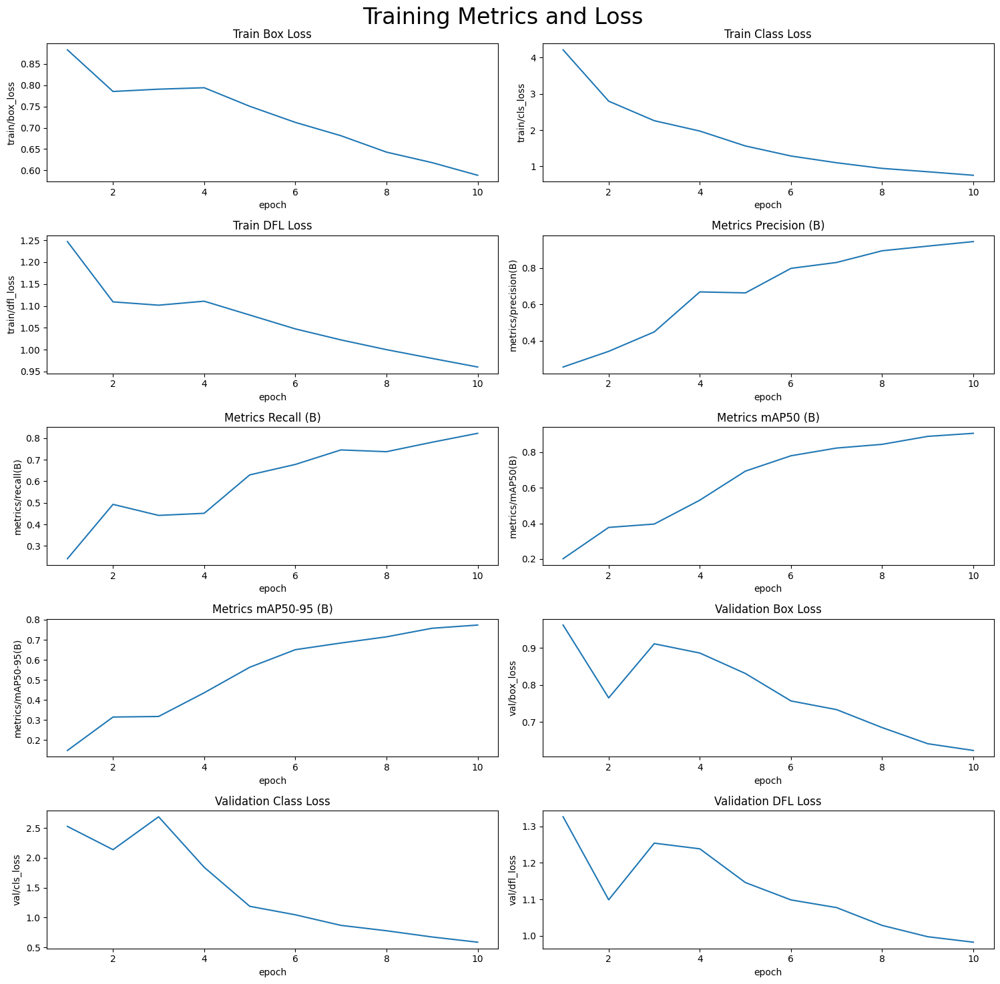

In [8]:
# Read the results.csv file as a pandas dataframe
Result_Final_model.columns = Result_Final_model.columns.str.strip()

# Create subplots
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))

# Plot the columns using seaborn
sns.lineplot(x='epoch', y='train/box_loss', data=Result_Final_model, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=Result_Final_model, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=Result_Final_model, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=Result_Final_model, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=Result_Final_model, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=Result_Final_model, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=Result_Final_model, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=Result_Final_model, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=Result_Final_model, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=Result_Final_model, ax=axs[4,1])

# Set titles and axis labels for each subplot
axs[0,0].set(title='Train Box Loss')
axs[0,1].set(title='Train Class Loss')
axs[1,0].set(title='Train DFL Loss')
axs[1,1].set(title='Metrics Precision (B)')
axs[2,0].set(title='Metrics Recall (B)')
axs[2,1].set(title='Metrics mAP50 (B)')
axs[3,0].set(title='Metrics mAP50-95 (B)')
axs[3,1].set(title='Validation Box Loss')
axs[4,0].set(title='Validation Class Loss')
axs[4,1].set(title='Validation DFL Loss')


plt.suptitle('Training Metrics and Loss', fontsize=24)
plt.subplots_adjust(top=0.8)
plt.tight_layout()
plt.show()

In [17]:
# Loading the best performing model
Valid_model = YOLO('./runs/detect/train9/weights/best.pt')

# Evaluating the model on the validset
metrics = Valid_model.val(split = 'val')

# final results 
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
Model summary (fused): 168 layers, 3,008,573 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/valid/labels.cache... 801 ima
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 51/51 [00:10<


                   all        801        944      0.946      0.822      0.906      0.774
           Green Light         87        122      0.811      0.648      0.724      0.416
             Red Light         74        108      0.948       0.51       0.76      0.417
       Speed Limit 100         52         52      0.822      0.942      0.942      0.845
       Speed Limit 110         17         17      0.928      0.763      0.855      0.777
       Speed Limit 120         60         60      0.984       0.85      0.973      0.881
        Speed Limit 20         56         56      0.984      0.893      0.971      0.825
        Speed Limit 30         71         74          1      0.955      0.967      0.892
        Speed Limit 40         53         55      0.961      0.907      0.958      0.841
        Speed Limit 50         68         71      0.983      0.789      0.923      0.829
        Speed Limit 60         76         76      0.944      0.885      0.934      0.843
        Speed Limit 7


0: 640x640 1 Speed Limit 60, 3.6ms
Speed: 1.2ms preprocess, 3.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Speed Limit 100, 3.5ms
Speed: 1.2ms preprocess, 3.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Speed Limit 110, 1 Speed Limit 40, 3.5ms
Speed: 1.2ms preprocess, 3.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Speed Limit 30, 3.9ms
Speed: 1.1ms preprocess, 3.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Speed Limit 60, 3.3ms
Speed: 1.0ms preprocess, 3.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Speed Limit 70, 3.6ms
Speed: 1.1ms preprocess, 3.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 3.6ms
Speed: 1.1ms preprocess, 3.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Red Light, 3.6ms
Speed: 1.2ms preprocess, 3

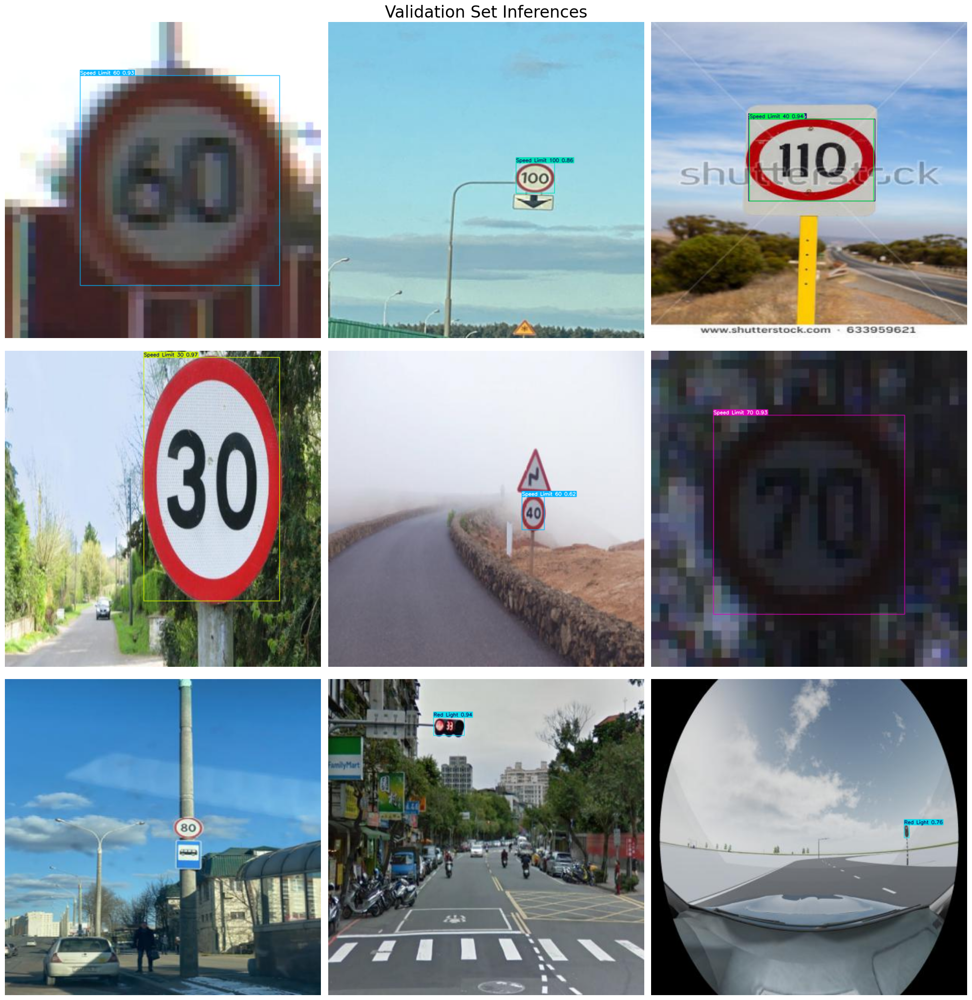

In [10]:
# Normalization function
def normalize_image(image):
    return image / 255.0

# Image resizing function
def resize_image(image, size=(640, 640)):
    return cv2.resize(image, size)

# Path to validation images
dataset_path = '/home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/car/'  # Place your dataset path here
valid_images_path = os.path.join(dataset_path, 'test', 'images')

# List of all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Check if there are images in the directory
if len(image_files) > 0:
    # Select 9 images at equal intervals
    num_images = len(image_files)
    step_size = max(1, num_images // 9)  # Ensure the interval is at least 1
    selected_images = [image_files[i] for i in range(0, num_images, step_size)]

    # Prepare subplots
    fig, axes = plt.subplots(3, 3, figsize=(20, 21))
    fig.suptitle('Validation Set Inferences', fontsize=24)

    for i, ax in enumerate(axes.flatten()):
        if i < len(selected_images):
            image_path = os.path.join(valid_images_path, selected_images[i])
            
            # Load image
            image = cv2.imread(image_path)
            
            # Check if the image is loaded correctly
            if image is not None:
                # Resize image
                resized_image = resize_image(image, size=(640, 640))
                # Normalize image
                normalized_image = normalize_image(resized_image)
                
                # Convert the normalized image to uint8 data type
                normalized_image_uint8 = (normalized_image * 255).astype(np.uint8)
                
                # Predict with the model
                results = Valid_model.predict(source=normalized_image_uint8, imgsz=640, conf=0.5)
                
                # Plot image with labels
                annotated_image = results[0].plot(line_width=1)
                annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
                ax.imshow(annotated_image_rgb)
            else:
                print(f"Failed to load image {image_path}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()


In [12]:
import shutil
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join('./runs/detect/train9', 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)
# Define the path to the sample video in the dataset
dataset_video_path = '/home/mist861/.cache/kagglehub/datasets/pkdarabi/cardetection/versions/5/video.mp4'

# Define the destination path in the working directory
video_path = './runs/detect/train9/sample_video.mp4'

# Copy the video file from its original location in the dataset to the current working directory in Kaggle for further processing
shutil.copyfile(dataset_video_path, video_path)

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/508) /home/mist861/github/5567-Deep-Learning/Project_3/Part A/runs/detect/train9/sample_video.mp4: 640x640 1 Stop, 3.5ms
video 1/1 (frame 2/508) /home/mist861/github/5567-Deep-Learning/Project_3/Part A/runs/detect/train9/sample_video.mp4: 640x640 1 Stop, 3.5ms
video 1/1 (frame 3/508) /home/mist861/github/5567-Deep-Learning/Project_3/Part A/runs/detect/train9/sample_video.mp4: 640x640 1 Stop, 3.8ms
video 1/1 (frame 4/508) /home/mist86

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Green Light', 1: 'Red Light', 2: 'Speed Limit 10', 3: 'Speed Limit 100', 4: 'Speed Limit 110', 5: 'Speed Limit 120', 6: 'Speed Limit 20', 7: 'Speed Limit 30', 8: 'Speed Limit 40', 9: 'Speed Limit 50', 10: 'Speed Limit 60', 11: 'Speed Limit 70', 12: 'Speed Limit 80', 13: 'Speed Limit 90', 14: 'Stop'}
 obb: None
 orig_img: array([[[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        ...,
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
     

In [14]:
# Convert the .avi video generated by the YOLOv8 prediction to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i ./runs/detect/train9/sample_video.mp4 processed_sample_video.mp4

# Embed and display the processed sample video within the notebook
Video("processed_sample_video.mp4", embed=True, width=960)

# New Dataset

In [2]:
!pip install roboflow

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 65.6 MB/s eta 0:00:00a 0:00:01
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


In [5]:
from roboflow import Roboflow
rf = Roboflow(api_key="*********")
project = rf.workspace("brad-dwyer").project("oxford-pets") # https://public.roboflow.com/object-detection/oxford-pets/2
version = project.version(2)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Oxford-Pets-2 in yolov8:: 100%|████████████████| 7372/7372 [00:00<00:00, 34437.63it/s]


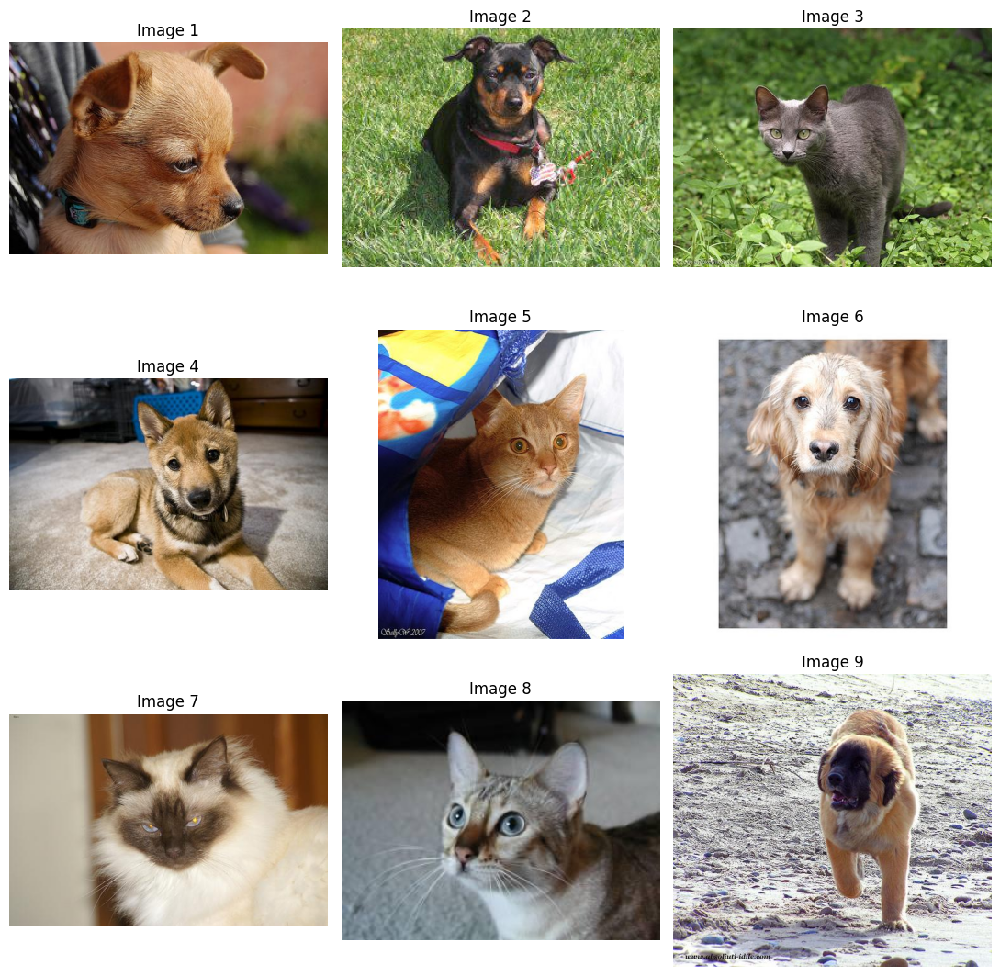

In [10]:
Image_dir = '../Oxford-Pets-2/train/images'

num_samples = 9
image_files = os.listdir(Image_dir)

# Randomly select num_samples images
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(Image_dir, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [11]:
# Get the size of the image
image = cv2.imread("../Oxford-Pets-2/train/images/yorkshire_terrier_14_jpg.rf.5c6639de2678f11b3a7d5f8508c5a67a.jpg")
h, w, c = image.shape
print(f"The image has dimensions {w}x{h} and {c} channels.")

The image has dimensions 356x500 and 3 channels.



image 1/1 /home/mist861/github/5567-Deep-Learning/Project_3/Part A/../Oxford-Pets-2/train/images/yorkshire_terrier_14_jpg.rf.5c6639de2678f11b3a7d5f8508c5a67a.jpg: 640x480 2 dogs, 34.0ms
Speed: 1.0ms preprocess, 34.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


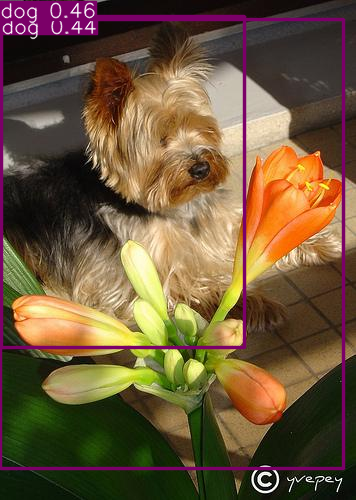

In [12]:
# Use a pretrained YOLOv8n model
pet_model = YOLO("yolov8n.pt") 

# Use the model to detect object
image = "../Oxford-Pets-2/train/images/yorkshire_terrier_14_jpg.rf.5c6639de2678f11b3a7d5f8508c5a67a.jpg"
result_predict = pet_model.predict(source = image, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [14]:
# Build from YAML and transfer weights
pet_final_model = YOLO('yolov8n.pt')  

# Training The Final Model
pet_result_final_model = pet_final_model.train(data="../Oxford-Pets-2/data.yaml",epochs = 10, batch = 32, optimizer = 'sgd', lr0=0.01)


New https://pypi.org/project/ultralytics/8.3.29 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=../Oxford-Pets-2/data.yaml, epochs=10, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train12, exist_ok=False, pretrained=True, optimizer=sgd, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None

E0000 00:00:1731518883.675083    4302 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1731518883.690242    4302 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /home/mist861/github/5567-Deep-Learning/Project_3/Oxford-Pets-2/train/labels... 2576 images, 0 backgroun

train: New cache created: /home/mist861/github/5567-Deep-Learning/Project_3/Oxford-Pets-2/train/labels.cache



val: Scanning /home/mist861/github/5567-Deep-Learning/Project_3/Oxford-Pets-2/valid/labels... 736 images, 0 backgrounds,

val: New cache created: /home/mist861/github/5567-Deep-Learning/Project_3/Oxford-Pets-2/valid/labels.cache


Plotting labels to runs/detect/train12/labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train12
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      4.16G      1.013      2.723      1.343         16        640: 100%|██████████| 81/81 [00:11<00:00,  7.2
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.869      0.602      0.784      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      4.12G     0.9129      1.214      1.223         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.871      0.863      0.915      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      4.12G     0.9537      1.075      1.248         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.9
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.637      0.594      0.624      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      4.11G      1.031      1.105      1.308         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.743      0.616      0.703       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      4.11G     0.9749     0.9518      1.265         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.889      0.822       0.91      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      4.11G     0.8899     0.8178      1.195         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.883      0.868      0.926      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      4.11G     0.8423     0.7241      1.143         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.9
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.938      0.863      0.939      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      4.11G     0.7669     0.6373      1.099         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<

                   all        736        738      0.939      0.893      0.962      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      4.11G     0.7171     0.5604      1.075         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<

                   all        736        738      0.943      0.917      0.967      0.784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      4.11G     0.6677     0.4994      1.037         16        640: 100%|██████████| 81/81 [00:10<00:00,  8.0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<

                   all        736        738      0.955      0.961      0.986      0.818



10 epochs completed in 0.036 hours.
Optimizer stripped from runs/detect/train12/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train12/weights/best.pt, 6.2MB

Validating runs/detect/train12/weights/best.pt...
Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<


                   all        736        738      0.956      0.961      0.986      0.819
                   cat        249        251      0.941      0.976      0.985       0.86
                   dog        487        487       0.97      0.947      0.986      0.778
Speed: 0.2ms preprocess, 0.6ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/detect/train12


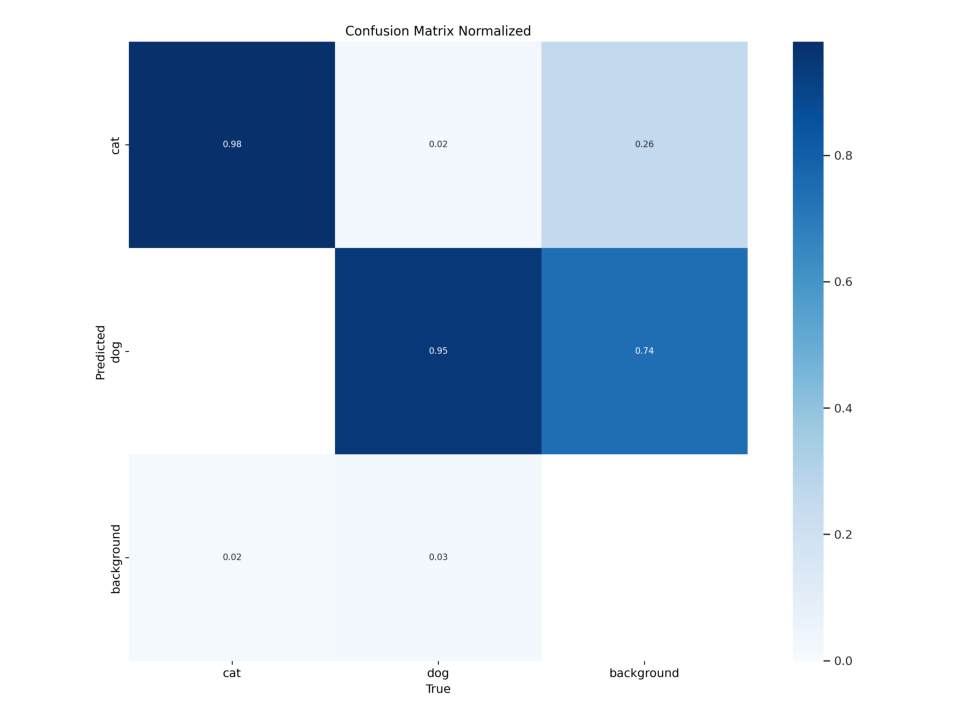

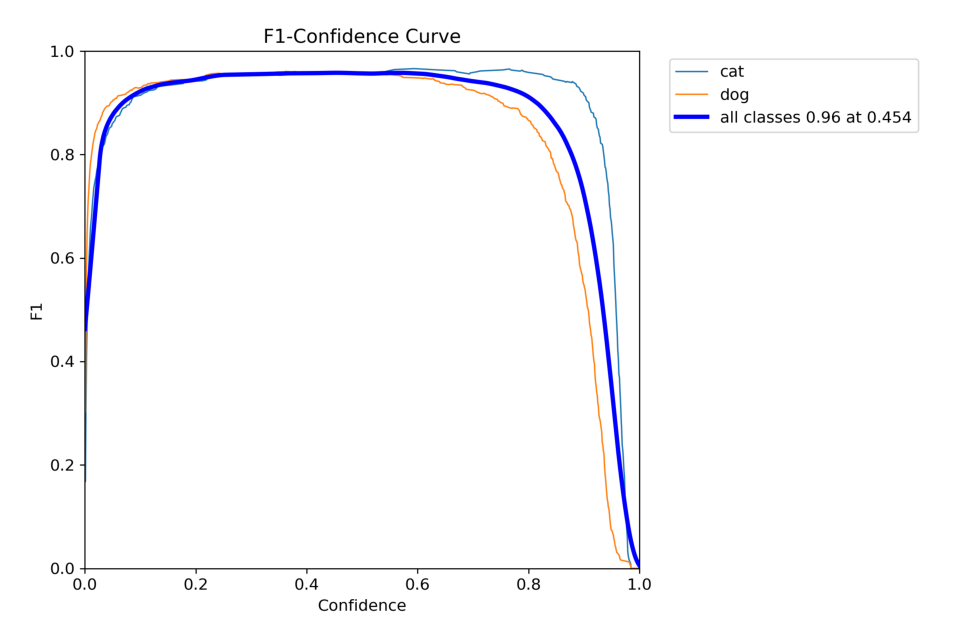

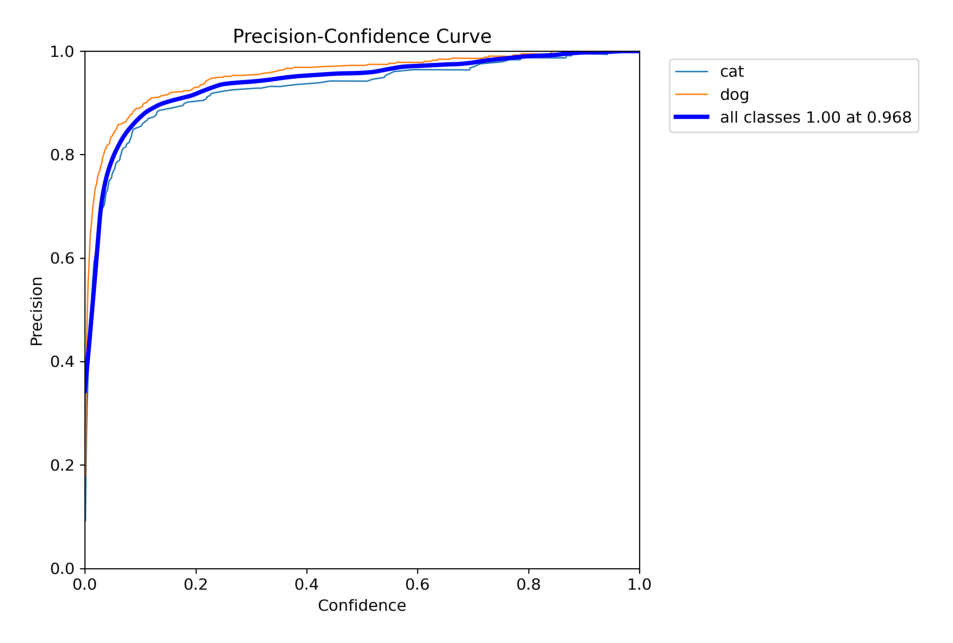

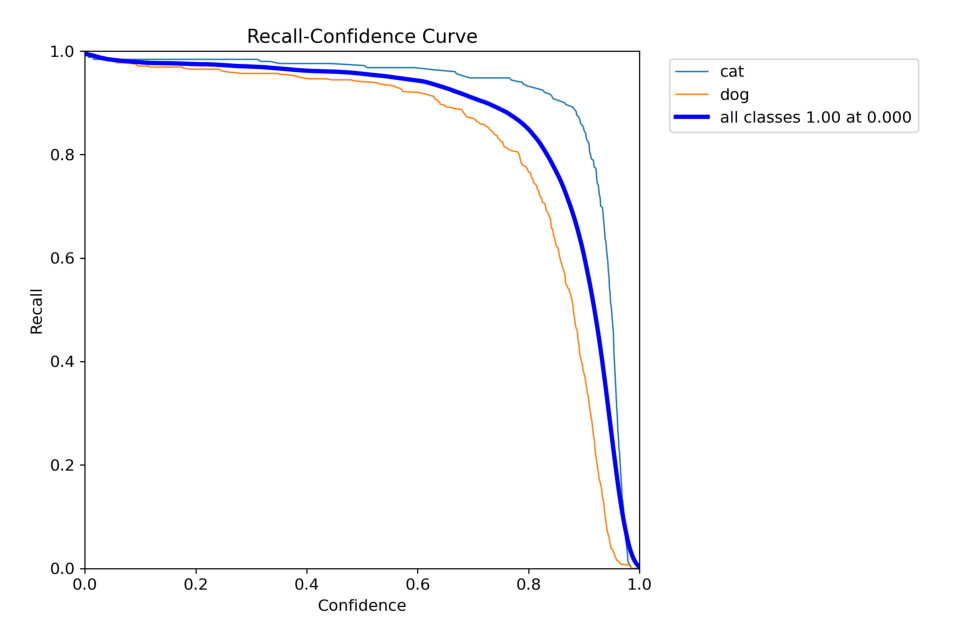

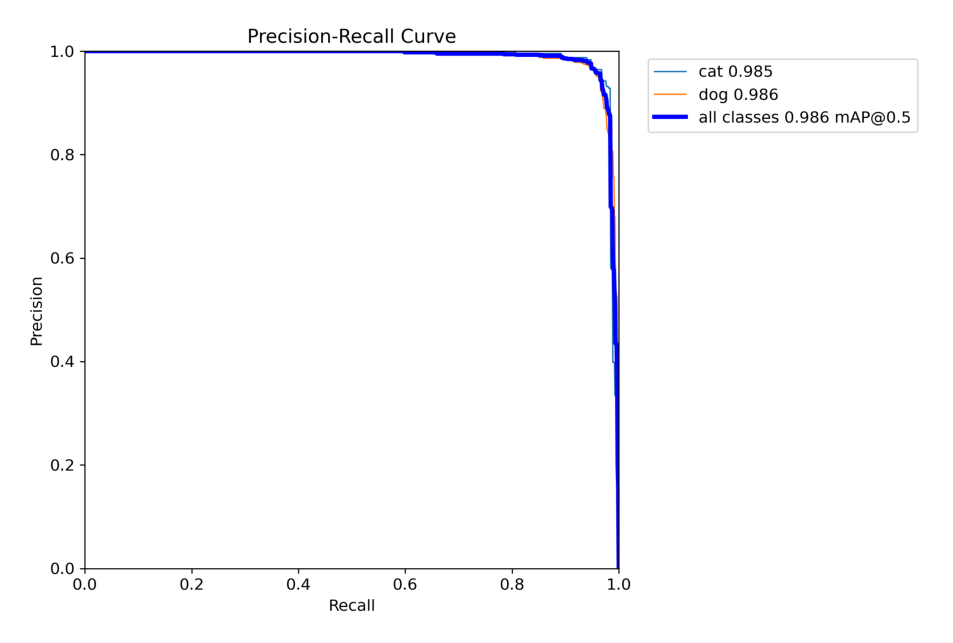

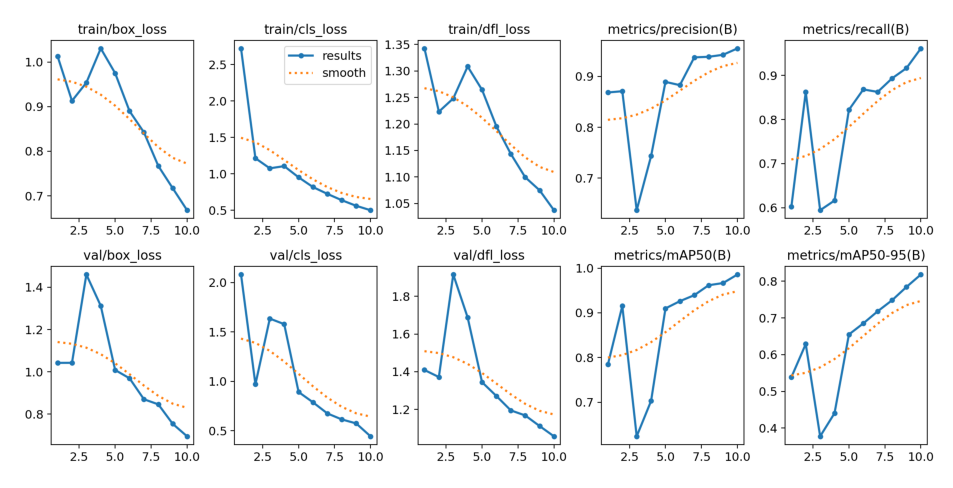

In [15]:
import os
import cv2
import matplotlib.pyplot as plt

def display_images(post_training_files_path, image_files):

    for image_file in image_files:
        image_path = os.path.join(post_training_files_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        plt.figure(figsize=(10, 10), dpi=120)
        plt.imshow(img)
        plt.axis('off')
        plt.show()

# List of image files to display
image_files = [
    'confusion_matrix_normalized.png',
    'F1_curve.png',
    'P_curve.png',
    'R_curve.png',
    'PR_curve.png',
    'results.png'
]

# Path to the directory containing the images
post_training_files_path = './runs/detect/train12'

# Display the images
display_images(post_training_files_path, image_files)

In [17]:
pet_result_final_model = pd.read_csv('./runs/detect/train12/results.csv')
pet_result_final_model.head(10)

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,15.7114,1.01286,2.72319,1.34264,0.86855,0.60212,0.78437,0.53833,1.04242,2.08037,1.40921,0.070370,0.003292,0.003292
1,2,28.6501,0.91294,1.21391,1.22313,0.87099,0.86259,0.91547,0.62893,1.04263,0.96951,1.37187,0.039714,0.005970,0.005970
2,3,41.1614,0.95372,1.07545,1.24816,0.63677,0.59435,0.62368,0.37734,1.46035,1.63440,1.91544,0.008399,0.007987,0.007987
3,4,53.9602,1.03050,1.10544,1.30849,0.74340,0.61637,0.70288,0.44041,1.31214,1.57827,1.68775,0.007030,0.007030,0.007030
4,5,66.7281,0.97495,0.95176,1.26453,0.88937,0.82209,0.90989,0.65497,1.00857,0.89173,1.34463,0.006040,0.006040,0.006040
5,6,79.5129,0.88994,0.81780,1.19530,0.88291,0.86831,0.92608,0.68518,0.96951,0.78755,1.27115,0.005050,0.005050,0.005050
6,7,92.3572,0.84230,0.72411,1.14343,0.93759,0.86271,0.93946,0.71821,0.87029,0.67495,1.19507,0.004060,0.004060,0.004060
7,8,104.9700,0.76694,0.63725,1.09938,0.93877,0.89349,0.96179,0.74826,0.84619,0.61449,1.16830,0.003070,0.003070,0.003070
8,9,117.5990,0.71711,0.56041,1.07474,0.94269,0.91664,0.96663,0.78449,0.75403,0.57415,1.11213,0.002080,0.002080,0.002080
9,10,129.9890,0.66775,0.49941,1.03708,0.95525,0.96135,0.98574,0.81834,0.69492,0.44329,1.05749,0.001090,0.001090,0.001090


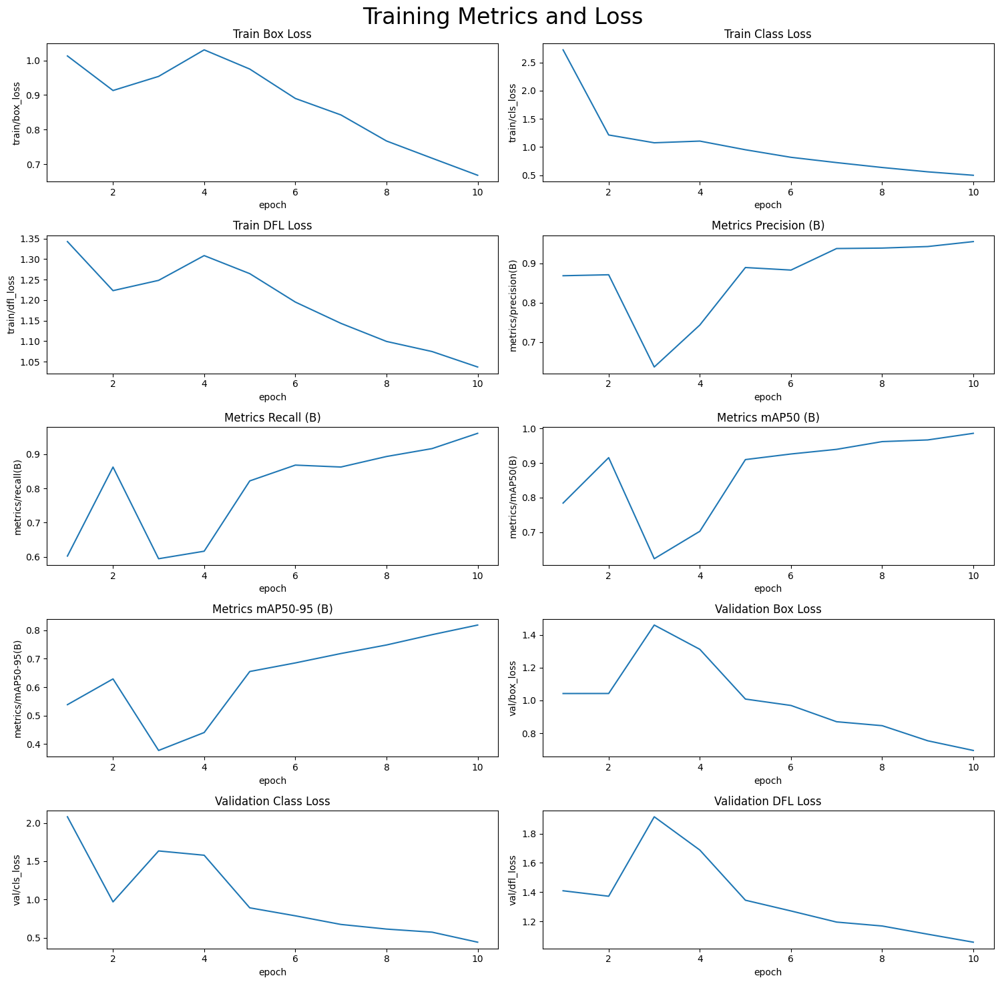

In [18]:
# Read the results.csv file as a pandas dataframe
pet_result_final_model.columns = Result_Final_model.columns.str.strip()

# Create subplots
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))

# Plot the columns using seaborn
sns.lineplot(x='epoch', y='train/box_loss', data=Result_Final_model, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=Result_Final_model, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=Result_Final_model, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=Result_Final_model, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=Result_Final_model, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=Result_Final_model, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=Result_Final_model, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=Result_Final_model, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=Result_Final_model, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=Result_Final_model, ax=axs[4,1])

# Set titles and axis labels for each subplot
axs[0,0].set(title='Train Box Loss')
axs[0,1].set(title='Train Class Loss')
axs[1,0].set(title='Train DFL Loss')
axs[1,1].set(title='Metrics Precision (B)')
axs[2,0].set(title='Metrics Recall (B)')
axs[2,1].set(title='Metrics mAP50 (B)')
axs[3,0].set(title='Metrics mAP50-95 (B)')
axs[3,1].set(title='Validation Box Loss')
axs[4,0].set(title='Validation Class Loss')
axs[4,1].set(title='Validation DFL Loss')


plt.suptitle('Training Metrics and Loss', fontsize=24)
plt.subplots_adjust(top=0.8)
plt.tight_layout()
plt.show()

In [20]:
# Loading the best performing model
pet_valid_model = YOLO('./runs/detect/train12/weights/best.pt')

# Evaluating the model on the validset
metrics = pet_valid_model.val(split = 'val')

# final results 
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/mist861/github/5567-Deep-Learning/Project_3/Oxford-Pets-2/valid/labels.cache... 736 images, 0 backgr
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:03<


                   all        736        738      0.966      0.949      0.986      0.819
                   cat        249        251      0.953      0.968      0.986       0.86
                   dog        487        487      0.978       0.93      0.986      0.779
Speed: 0.2ms preprocess, 1.3ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/detect/val7
precision(B):  0.9658570108058675
metrics/recall(B):  0.9489372092572432
metrics/mAP50(B):  0.98603202108024
metrics/mAP50-95(B):  0.8194510194061646



0: 640x640 1 dog, 3.0ms
Speed: 1.0ms preprocess, 3.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 3.5ms
Speed: 0.9ms preprocess, 3.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 3.8ms
Speed: 1.1ms preprocess, 3.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 4.8ms
Speed: 1.2ms preprocess, 4.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 3.6ms
Speed: 0.9ms preprocess, 3.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 4.0ms
Speed: 0.9ms preprocess, 4.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 3.4ms
Speed: 2.2ms preprocess, 3.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 3.6ms
Speed: 1.5ms preprocess, 3.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 3.2ms
Speed: 

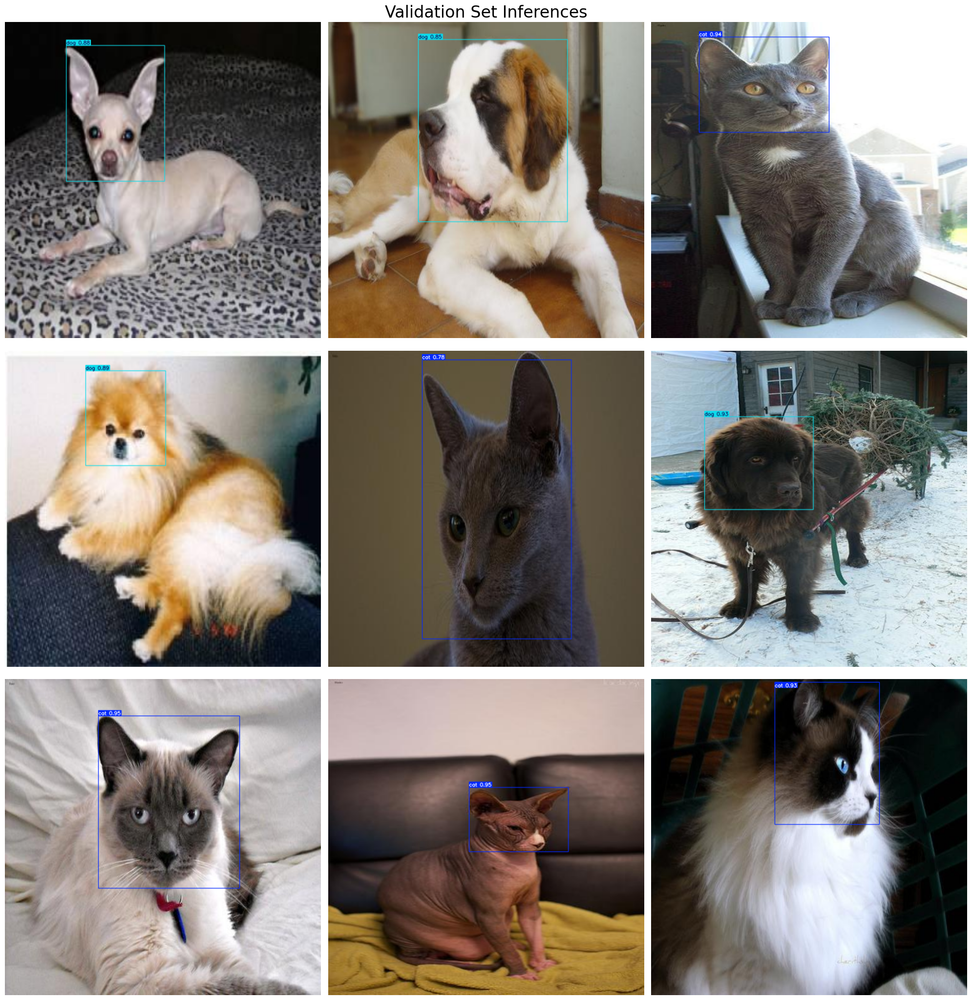

In [22]:
# Normalization function
def normalize_image(image):
    return image / 255.0

# Image resizing function
def resize_image(image, size=(640, 640)):
    return cv2.resize(image, size)

# Path to validation images
dataset_path = '../Oxford-Pets-2/'  # Place your dataset path here
valid_images_path = os.path.join(dataset_path, 'test', 'images')

# List of all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Check if there are images in the directory
if len(image_files) > 0:
    # Select 9 images at equal intervals
    num_images = len(image_files)
    step_size = max(1, num_images // 9)  # Ensure the interval is at least 1
    selected_images = [image_files[i] for i in range(0, num_images, step_size)]

    # Prepare subplots
    fig, axes = plt.subplots(3, 3, figsize=(20, 21))
    fig.suptitle('Validation Set Inferences', fontsize=24)

    for i, ax in enumerate(axes.flatten()):
        if i < len(selected_images):
            image_path = os.path.join(valid_images_path, selected_images[i])
            
            # Load image
            image = cv2.imread(image_path)
            
            # Check if the image is loaded correctly
            if image is not None:
                # Resize image
                resized_image = resize_image(image, size=(640, 640))
                # Normalize image
                normalized_image = normalize_image(resized_image)
                
                # Convert the normalized image to uint8 data type
                normalized_image_uint8 = (normalized_image * 255).astype(np.uint8)
                
                # Predict with the model
                results = pet_valid_model.predict(source=normalized_image_uint8, imgsz=640, conf=0.5)
                
                # Plot image with labels
                annotated_image = results[0].plot(line_width=1)
                annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
                ax.imshow(annotated_image_rgb)
            else:
                print(f"Failed to load image {image_path}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Newer Dataset

In [1]:
# Import Essential Libraries
import os
import random
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np  
import matplotlib.pyplot as plt
import seaborn as sns
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import warnings
warnings.filterwarnings('ignore')

In [1]:
rf = Roboflow(api_key="*********")
project = rf.workspace("brad-dwyer").project("oxford-pets") # https://public.roboflow.com/object-detection/oxford-pets/1
version = project.version(1)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Oxford-Pets-1 in yolov8:: 100%|████████████████| 7372/7372 [00:00<00:00, 36730.82it/s]


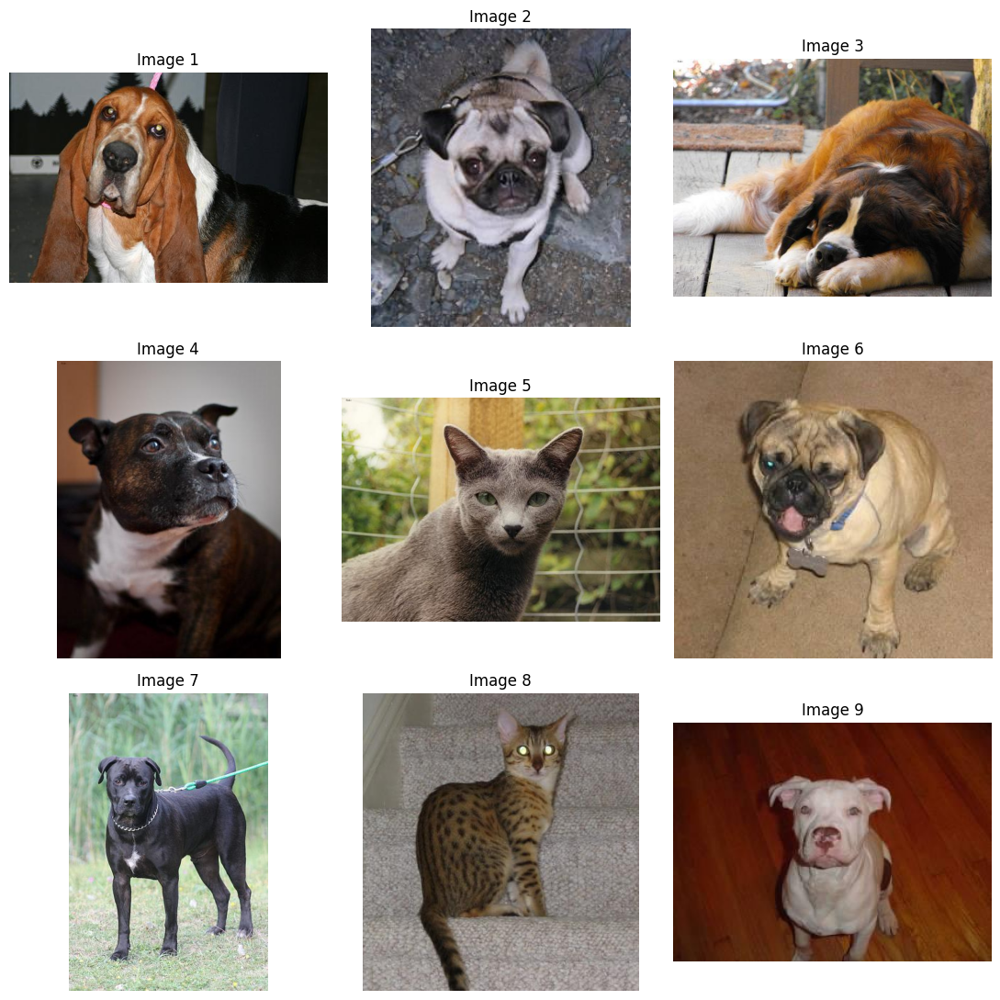

In [2]:
Image_dir = '../Oxford-Pets-1/train/images'

num_samples = 9
image_files = os.listdir(Image_dir)

# Randomly select num_samples images
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(Image_dir, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [3]:
# Get the size of the image
image = cv2.imread("../Oxford-Pets-1/train/images/yorkshire_terrier_185_jpg.rf.10f2ef2b0b67c15afa94f227be10e7a8.jpg")
h, w, c = image.shape
print(f"The image has dimensions {w}x{h} and {c} channels.")

The image has dimensions 375x500 and 3 channels.



image 1/1 /home/mist861/github/5567-Deep-Learning/Project_3/Part A/../Oxford-Pets-1/train/images/yorkshire_terrier_185_jpg.rf.10f2ef2b0b67c15afa94f227be10e7a8.jpg: 640x480 1 person, 1 dog, 44.9ms
Speed: 3.1ms preprocess, 44.9ms inference, 64.7ms postprocess per image at shape (1, 3, 640, 480)


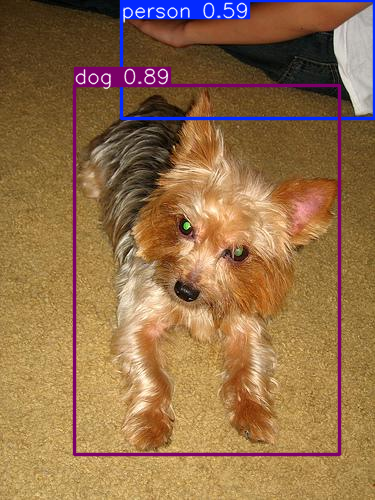

In [4]:
# Use a pretrained YOLOv8n model
pet_model = YOLO("yolov8n.pt") 

# Use the model to detect object
image = "../Oxford-Pets-1/train/images/yorkshire_terrier_185_jpg.rf.10f2ef2b0b67c15afa94f227be10e7a8.jpg"
result_predict = pet_model.predict(source = image, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [4]:
# Build from YAML and transfer weights
pet_final_model = YOLO('yolov8n.pt')  

# Training The Final Model
pet_result_final_model = pet_final_model.train(data="../Oxford-Pets-1/data.yaml",epochs = 30, batch = 32, optimizer = 'sgd', lr0=0.01)

New https://pypi.org/project/ultralytics/8.3.31 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=../Oxford-Pets-1/data.yaml, epochs=30, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train27, exist_ok=False, pretrained=True, optimizer=sgd, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None

E0000 00:00:1731779481.399449   29860 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1731779481.412782   29860 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Overriding model.yaml nc=80 with nc=37

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

train: Scanning /home/mist861/github/5567-Deep-Learning/Project_3/Oxford-Pets-1/train/labels.cache... 2576 images, 0 bac
val: Scanning /home/mist861/github/5567-Deep-Learning/Project_3/Oxford-Pets-1/valid/labels.cache... 736 images, 0 backgr


Plotting labels to runs/detect/train27/labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train27
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      4.23G     0.9785       4.58      1.321         39        640: 100%|██████████| 81/81 [00:11<00:00,  7.0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738     0.0221      0.579     0.0478     0.0332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      4.22G     0.9828      3.769      1.301         28        640: 100%|██████████| 81/81 [00:10<00:00,  7.3
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.169      0.289      0.137      0.101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      4.21G      1.025      3.273      1.289         39        640: 100%|██████████| 81/81 [00:10<00:00,  7.4
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.172      0.338      0.161      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      4.21G      1.097      3.061      1.308         35        640: 100%|██████████| 81/81 [00:10<00:00,  7.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.169      0.377      0.181      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      4.21G       1.08      2.778      1.263         37        640: 100%|██████████| 81/81 [00:10<00:00,  7.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.238      0.232      0.164      0.113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      4.21G      1.028      2.525      1.242         44        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.335      0.442      0.327      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      4.21G      1.006      2.376      1.222         35        640: 100%|██████████| 81/81 [00:10<00:00,  7.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.423      0.615      0.514      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      4.21G     0.9702      2.164      1.198         34        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.516      0.564      0.575      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      4.21G     0.9365      2.023      1.168         25        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738       0.44      0.522      0.463      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      4.21G     0.9066      1.888      1.151         36        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.463      0.511      0.501      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      4.21G     0.8827      1.807       1.14         34        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.616      0.674      0.703      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      4.21G     0.8661      1.675      1.127         32        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.586      0.641      0.663      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      4.21G     0.8358        1.6      1.111         38        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.603      0.643      0.686      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      4.21G     0.8268      1.508      1.098         31        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.608      0.612      0.661      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      4.21G     0.7994       1.42      1.088         37        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.682      0.686      0.749      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      4.21G     0.7717      1.355      1.072         32        640: 100%|██████████| 81/81 [00:10<00:00,  7.4
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738       0.66      0.651      0.722      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      4.21G     0.7775      1.298      1.078         33        640: 100%|██████████| 81/81 [00:10<00:00,  7.4
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.683      0.723      0.776      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      4.21G     0.7596      1.248      1.066         34        640: 100%|██████████| 81/81 [00:10<00:00,  7.4
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.743      0.735      0.803      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      4.21G     0.7352      1.185      1.058         31        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738       0.74      0.771      0.809      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      4.21G     0.7341      1.136      1.056         36        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.725      0.788      0.835        0.7


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      4.21G     0.5975     0.9985     0.9918         16        640: 100%|██████████| 81/81 [00:11<00:00,  7.2
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.723      0.777      0.817      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      4.21G     0.5779     0.9338     0.9656         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.712      0.716      0.781      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      4.21G     0.5644     0.8665     0.9667         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738       0.82      0.718      0.837      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      4.21G     0.5511     0.8127     0.9545         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.778      0.774       0.85      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      4.21G      0.527     0.7329     0.9484         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.804      0.786       0.86      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      4.21G     0.5139     0.6869     0.9349         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.831      0.803      0.875      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      4.21G     0.5022      0.657     0.9318         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.821      0.811      0.878      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      4.21G      0.488     0.6251     0.9191         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.843      0.811      0.882      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      4.21G     0.4721     0.5857     0.9142         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.843      0.806      0.888       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      4.21G     0.4593     0.5551     0.9037         16        640: 100%|██████████| 81/81 [00:10<00:00,  7.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<

                   all        736        738      0.843      0.829      0.892      0.768



30 epochs completed in 0.111 hours.
Optimizer stripped from runs/detect/train27/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train27/weights/best.pt, 6.2MB

Validating runs/detect/train27/weights/best.pt...
Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
Model summary (fused): 168 layers, 3,012,863 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<


                   all        736        738      0.844      0.828      0.892      0.768
        cat-Abyssinian         17         17      0.941      0.945      0.986      0.927
            cat-Bengal         24         26       0.92      0.445      0.741      0.675
            cat-Birman         26         26      0.832      0.885       0.92      0.805
            cat-Bombay         24         24      0.954      0.958       0.99      0.927
 cat-British_Shorthair         20         20      0.825       0.95      0.944      0.855
      cat-Egyptian_Mau         18         18      0.545      0.889      0.741      0.692
        cat-Maine_Coon         19         19      0.931          1      0.995      0.877
           cat-Persian         19         19      0.974          1      0.995      0.811
           cat-Ragdoll         20         20      0.904       0.75      0.857      0.773
      cat-Russian_Blue         26         26      0.915      0.923       0.96      0.911
           cat-Siames

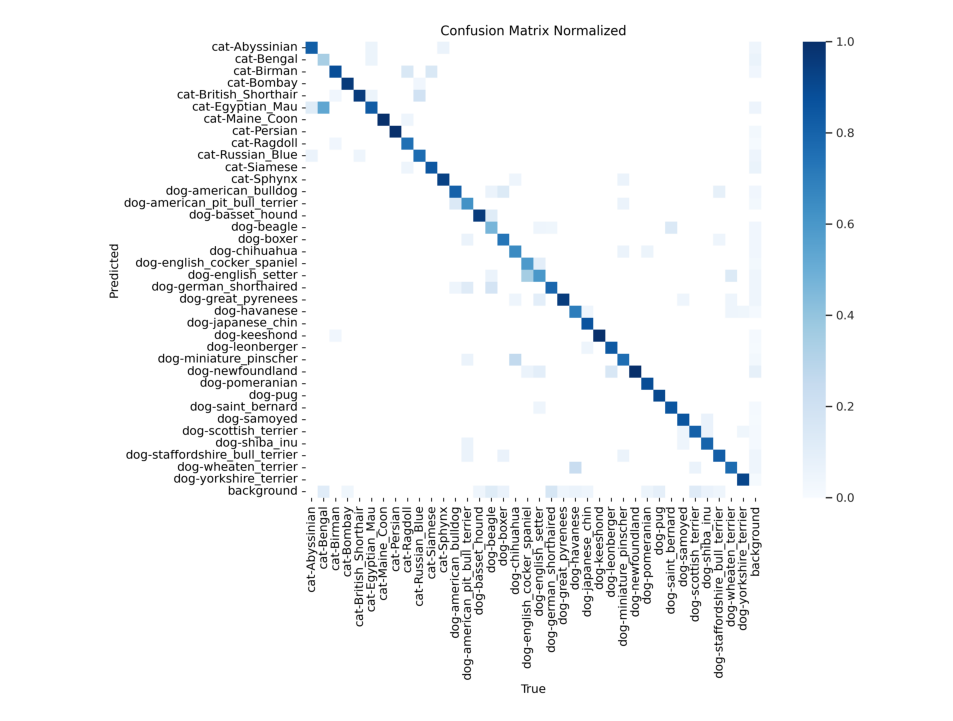

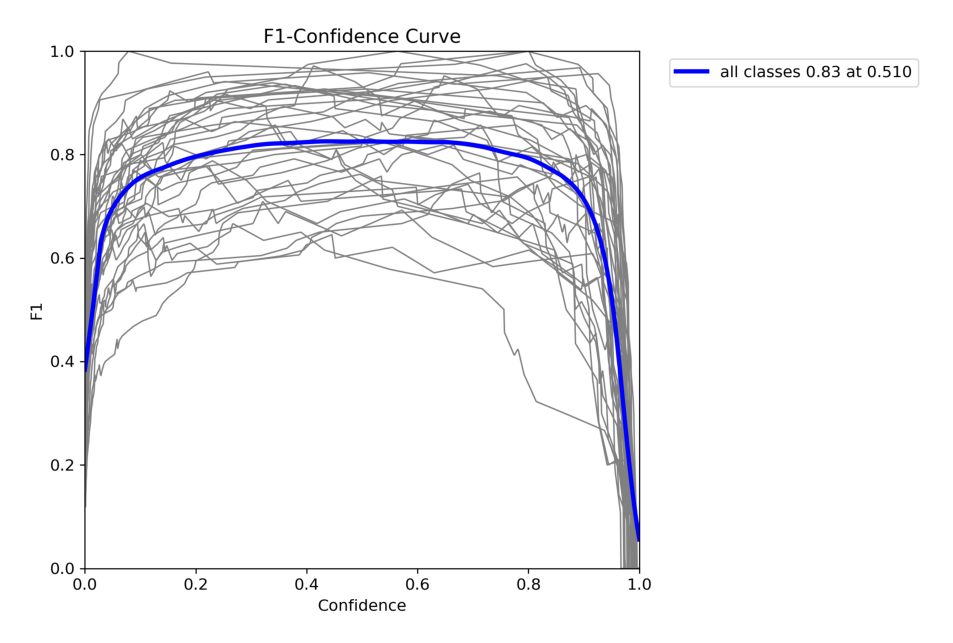

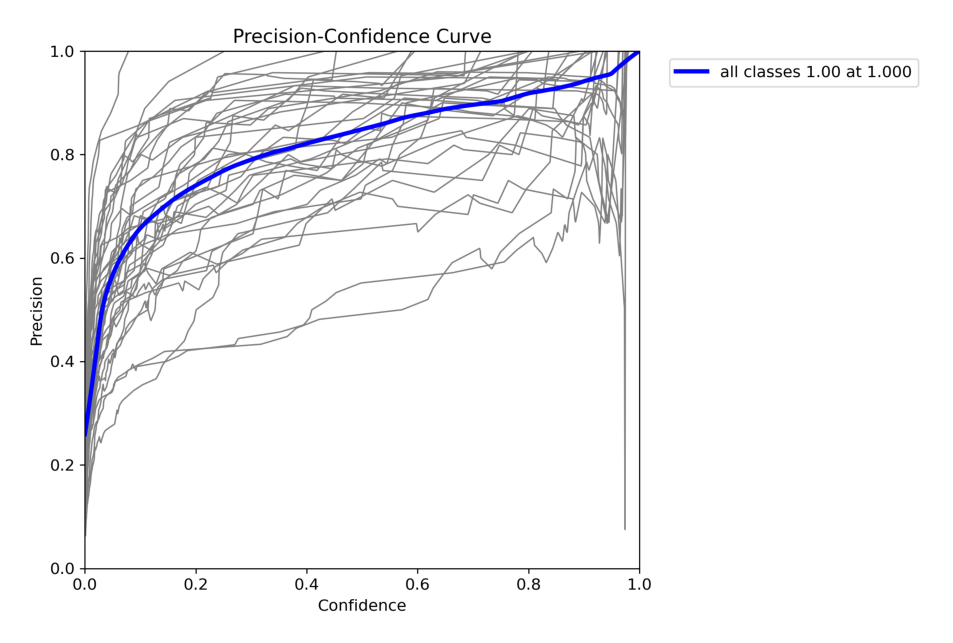

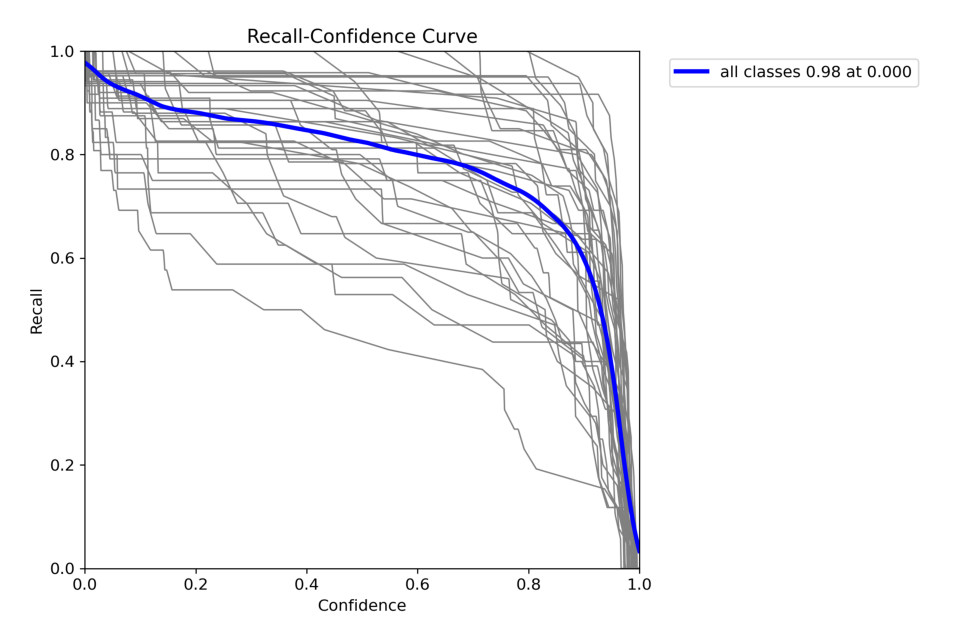

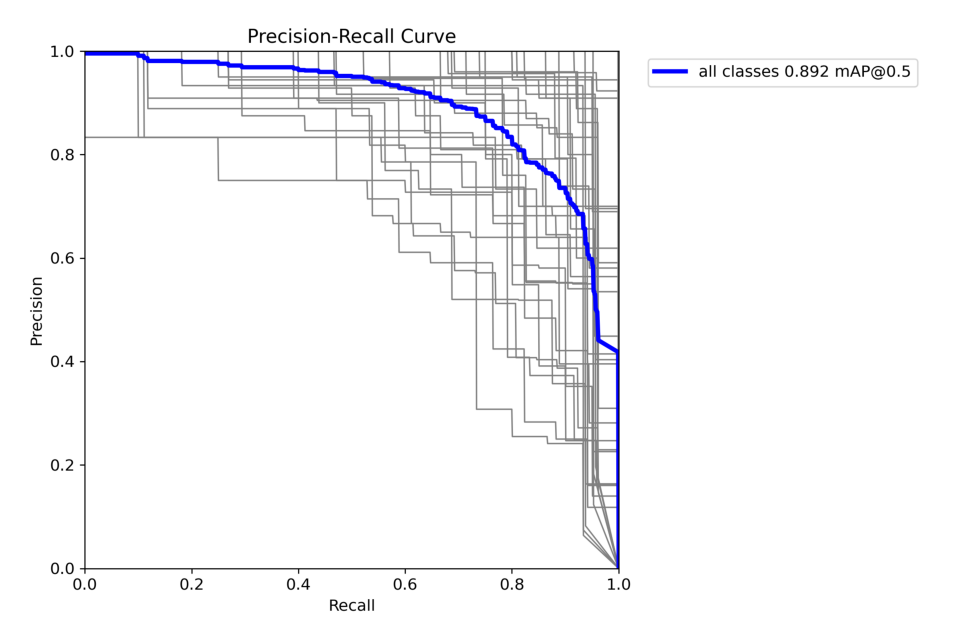

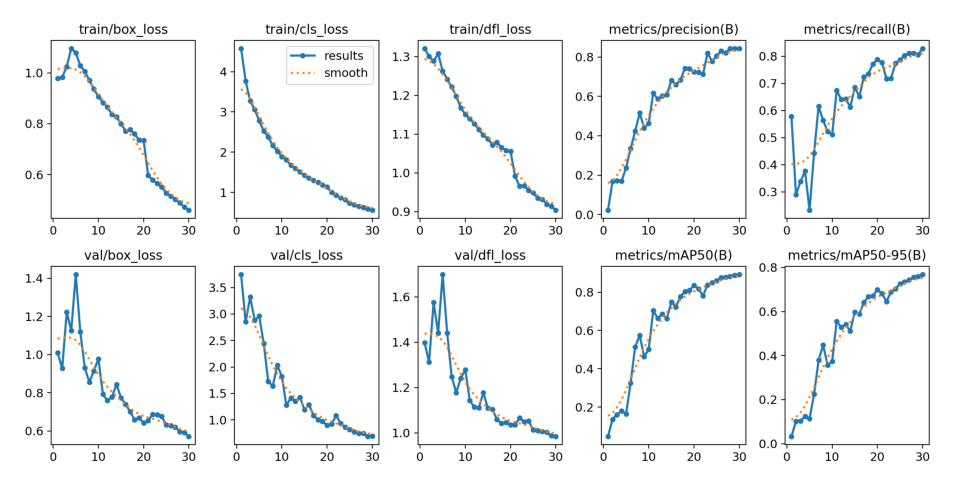

In [6]:
def display_images(post_training_files_path, image_files):

    for image_file in image_files:
        image_path = os.path.join(post_training_files_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        plt.figure(figsize=(10, 10), dpi=120)
        plt.imshow(img)
        plt.axis('off')
        plt.show()

# List of image files to display
image_files = [
    'confusion_matrix_normalized.png',
    'F1_curve.png',
    'P_curve.png',
    'R_curve.png',
    'PR_curve.png',
    'results.png'
]

# Path to the directory containing the images
post_training_files_path = './runs/detect/train27'

# Display the images
display_images(post_training_files_path, image_files)

In [5]:
# Loading the best performing model
pet_valid_model = YOLO('./runs/detect/train27/weights/best.pt')

# Evaluating the model on the validset
metrics = pet_valid_model.val(split = 'val')

# final results 
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

Ultralytics 8.3.28 🚀 Python-3.12.7 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080 Laptop GPU, 12282MiB)
Model summary (fused): 168 layers, 3,012,863 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/mist861/github/5567-Deep-Learning/Project_3/Oxford-Pets-1/valid/labels.cache... 736 images, 0 backgr
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:03<


                   all        736        738      0.844      0.836      0.891      0.765
        cat-Abyssinian         17         17      0.942      0.958      0.986      0.927
            cat-Bengal         24         26      0.921      0.451      0.713      0.652
            cat-Birman         26         26      0.821      0.923      0.911      0.799
            cat-Bombay         24         24       0.95      0.958       0.99      0.907
 cat-British_Shorthair         20         20      0.782       0.95      0.944      0.852
      cat-Egyptian_Mau         18         18      0.536      0.889      0.754      0.706
        cat-Maine_Coon         19         19      0.929          1      0.995      0.874
           cat-Persian         19         19      0.981          1      0.995      0.813
           cat-Ragdoll         20         20      0.896       0.75      0.849      0.768
      cat-Russian_Blue         26         26      0.923      0.923      0.957      0.908
           cat-Siames


0: 640x640 2 dog-shiba_inus, 4.0ms
Speed: 1.2ms preprocess, 4.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog-great_pyrenees, 3.6ms
Speed: 1.0ms preprocess, 3.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 3.6ms
Speed: 0.9ms preprocess, 3.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat-Sphynx, 3.4ms
Speed: 1.3ms preprocess, 3.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog-american_pit_bull_terrier, 1 dog-shiba_inu, 3.8ms
Speed: 1.0ms preprocess, 3.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog-newfoundland, 3.9ms
Speed: 1.1ms preprocess, 3.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog-yorkshire_terrier, 3.7ms
Speed: 1.0ms preprocess, 3.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog-beagle, 3.5ms
Spee

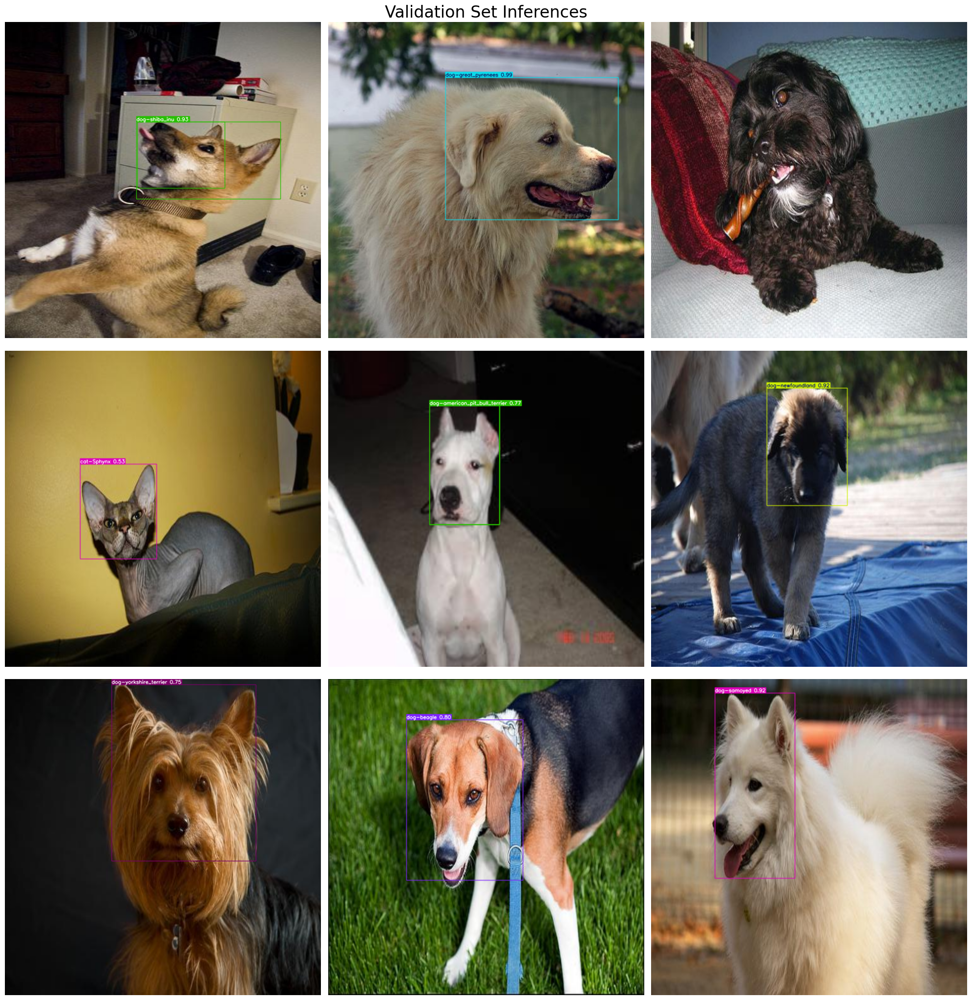

In [7]:
# Normalization function
def normalize_image(image):
    return image / 255.0

# Image resizing function
def resize_image(image, size=(640, 640)):
    return cv2.resize(image, size)

# Path to validation images
dataset_path = '../Oxford-Pets-1/'  # Place your dataset path here
valid_images_path = os.path.join(dataset_path, 'test', 'images')

# List of all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Check if there are images in the directory
if len(image_files) > 0:
    # Select 9 images at equal intervals
    num_images = len(image_files)
    step_size = max(1, num_images // 9)  # Ensure the interval is at least 1
    selected_images = [image_files[i] for i in range(0, num_images, step_size)]

    # Prepare subplots
    fig, axes = plt.subplots(3, 3, figsize=(20, 21))
    fig.suptitle('Validation Set Inferences', fontsize=24)

    for i, ax in enumerate(axes.flatten()):
        if i < len(selected_images):
            image_path = os.path.join(valid_images_path, selected_images[i])
            
            # Load image
            image = cv2.imread(image_path)
            
            # Check if the image is loaded correctly
            if image is not None:
                # Resize image
                resized_image = resize_image(image, size=(640, 640))
                # Normalize image
                normalized_image = normalize_image(resized_image)
                
                # Convert the normalized image to uint8 data type
                normalized_image_uint8 = (normalized_image * 255).astype(np.uint8)
                
                # Predict with the model
                results = pet_valid_model.predict(source=normalized_image_uint8, imgsz=640, conf=0.5)
                
                # Plot image with labels
                annotated_image = results[0].plot(line_width=1)
                annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
                ax.imshow(annotated_image_rgb)
            else:
                print(f"Failed to load image {image_path}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()